# Libraries and functions

In [1]:
#import required libraries
import numpy as np
import pandas as pd
import folium
import geopandas as gpd
from folium import plugins
from folium.plugins import HeatMap
from folium.plugins import FloatImage
from shapely.geometry import box
from shapely.geometry import MultiLineString
import branca
from colour import Color
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

In [2]:
#CODE BORROWED FROM https://nbviewer.jupyter.org/gist/BibMartin/f153aa957ddc5fadc64929abdee9ff2e
from branca.element import MacroElement

from jinja2 import Template

class BindColormap(MacroElement):
    """Binds a colormap to a given layer.

    Parameters
    ----------
    colormap : branca.colormap.ColorMap
        The colormap to bind.
    """
    def __init__(self, layer, colormap):
        super(BindColormap, self).__init__()
        self.layer = layer
        self.colormap = colormap
        self._template = Template(u"""
        {% macro script(this, kwargs) %}
            {{this.colormap.get_name()}}.svg[0][0].style.display = 'block';
            {{this._parent.get_name()}}.on('overlayadd', function (eventLayer) {
                if (eventLayer.layer == {{this.layer.get_name()}}) {
                    {{this.colormap.get_name()}}.svg[0][0].style.display = 'block';
                }});
            {{this._parent.get_name()}}.on('overlayremove', function (eventLayer) {
                if (eventLayer.layer == {{this.layer.get_name()}}) {
                    {{this.colormap.get_name()}}.svg[0][0].style.display = 'none';
                }});
        {% endmacro %}
        """)  # noqa

In [3]:
#function for creating heatmap given lat, long and weight data
def create_heatmap(list_lat, list_long, map_osm, heat_name, list_weight = [], r = 20):
    #create feature layer
    feature = folium.map.FeatureGroup(name = heat_name, overlay = True, show = False)

    #if weights are given
    if (len(list_weight) > 0):
        #create heatmap
        plugins.HeatMap(zip(list_lat, list_long, list_weight), radius = r, gradient = {0.25: "blue", 0.4: "lightblue", 0.6: "lime", 0.8: "yellow", 1.0: "red"}).add_to(feature)

        #create legend
        legend = create_legend(list_weight)

        #add feature to map and bind feature and legend together
        map_osm.add_child(feature)
        map_osm.add_child(legend)
        map_osm.add_child(BindColormap(feature,legend))
    
    #otherwise don't use any weights
    else:
        #create heatmap
        plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.25: "blue", 0.4: "lightblue", 0.6: "lime", 0.8: "yellow", 1.0: "red"}).add_to(feature)

        #create legend
        legend = create_legend()

        #add feature to map and bind feature and legend together
        map_osm.add_child(feature)
        map_osm.add_child(legend)
        map_osm.add_child(BindColormap(feature,legend))


In [4]:
#function for creating heatmap given lat, long and weight data (specifically for incidents)
def create_heatmap_incidents(list_lat, list_long, map_osm, heat_name, list_weight = [], r = 20):
    #create feature layer
    feature = folium.map.FeatureGroup(name = heat_name, overlay = True, show = False)

    #if weights are given
    if (len(list_weight) > 0):
        #create heatmap
        
        #inferno color scheme
        # plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.025: "#2f0087", 0.0714285715: "#6200a4", 0.142857143: "#9200a6", 0.214285: "#ba2f8a", 0.28571: "#d85b69", 0.35714: "#ee8949", 0.42855: "#f6bd27", 0.5: "#e4fa15"}).add_to(feature)
        # plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.05: "#2f0087", 0.142857143: "#6200a4", 0.285714286: "#9200a6", 0.428571429: "#ba2f8a", 0.571428571: "#d85b69", 0.714285714: "#ee8949", 0.857142857: "#f6bd27", 1.0: "#e4fa15"}).add_to(feature)

        #inferno reversed
        # plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.025: "#e4fa15", 0.0714285715: "#f6bd27", 0.142857143: "#ee8949", 0.214285: "#d85b69", 0.28571: "#ba2f8a", 0.35714: "#9200a6", 0.42855: "#6200a4", 0.5: "#2f0087"}).add_to(feature)
        plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.05: "#e4fa15", 0.142857143: "#f6bd27", 0.285714286: "#ee8949",  0.428571429: "#d85b69", 0.571428571: "#ba2f8a", 0.714285714: "#9200a6", 0.857142857: "#6200a4", 1.0: "#2f0087"}).add_to(feature)

        #create legend
        legend = create_legend_incidents(list_weight)

        #add feature to map and bind feature and legend together
        map_osm.add_child(feature)
        map_osm.add_child(legend)
        map_osm.add_child(BindColormap(feature,legend))
    
    #otherwise don't use any weights
    else:
        #create heatmap

        #inferno color scheme
        # plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.025: "#2f0087", 0.0714285715: "#6200a4", 0.142857143: "#9200a6", 0.214285: "#ba2f8a", 0.28571: "#d85b69", 0.35714: "#ee8949", 0.42855: "#f6bd27", 0.5: "#e4fa15"}).add_to(feature)
        # plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.05: "#2f0087", 0.142857143: "#6200a4", 0.285714286: "#9200a6", 0.428571429: "#ba2f8a", 0.571428571: "#d85b69", 0.714285714: "#ee8949", 0.857142857: "#f6bd27", 1.0: "#e4fa15"}).add_to(feature)

        #inferno reversed
        # plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.025: "#e4fa15", 0.0714285715: "#f6bd27", 0.142857143: "#ee8949", 0.214285: "#d85b69", 0.28571: "#ba2f8a", 0.35714: "#9200a6", 0.42855: "#6200a4", 0.5: "#2f0087"}).add_to(feature)
        plugins.HeatMap(zip(list_lat, list_long), radius = r, gradient = {0.05: "#e4fa15", 0.142857143: "#f6bd27", 0.285714286: "#ee8949",  0.428571429: "#d85b69", 0.571428571: "#ba2f8a", 0.714285714: "#9200a6", 0.857142857: "#6200a4", 1.0: "#2f0087"}).add_to(feature)

        #create legend
        legend = create_legend_incidents()

        #add feature to map and bind feature and legend together
        map_osm.add_child(feature)
        map_osm.add_child(legend)
        map_osm.add_child(BindColormap(feature,legend))

In [5]:
#function for generating legend (returns a linear interpolated color gradient)
def create_legend(list_weight = []):
    #colors and their respective index values
    colors = ["blue", "lightblue", "lime", "yellow", "red"]
    index = [0.25, 0.4, 0.6, 0.8, 1.0]
    
    #if weights are given, scale the index
    if (len(list_weight) > 0):
        #scale index with weight values
        max_weight = max(list_weight)
        min_weight = min(list_weight)
        diff_weight = max_weight - min_weight
        index = [(i*diff_weight) + min_weight for i in index]

        #create a linear interpolation of colors
        colormap = branca.colormap.LinearColormap(colors = colors, index = index, vmin = min_weight, vmax = max_weight)
    
    #else, use standard index
    else:
        colormap = branca.colormap.LinearColormap(colors = colors, index = index)

    return colormap

In [6]:
#function for generating legend (returns a linear interpolated color gradient) (specifically for incidents)
def create_legend_incidents(list_weight = []):
    #colors and their respective index values
    # colors = ["#2f0087", "#6200a4", "#9200a6", "#ba2f8a", "#d85b69", "#ee8949", "#f6bd27", "#e4fa15"]
    colors = ["#e4fa15", "#f6bd27", "#ee8949", "#d85b69", "#ba2f8a", "#9200a6", "#6200a4", "#2f0087"]
    index = [0.05, 0.142857143, 0.285714286, 0.428571429, 0.571428571, 0.714285714, 0.857142857, 1.0]
    
    #if weights are given, scale the index
    if (len(list_weight) > 0):
        #scale index with weight values
        max_weight = max(list_weight)
        min_weight = min(list_weight)
        diff_weight = max_weight - min_weight
        index = [(i*diff_weight) + min_weight for i in index]

        #create a linear interpolation of colors
        colormap = branca.colormap.LinearColormap(colors = colors, index = index, vmin = min_weight, vmax = max_weight)
    
    #else, use standard index
    else:
        colormap = branca.colormap.LinearColormap(colors = colors, index = index)

    return colormap

In [7]:
#function for creating grid markers
def create_markers(map_osm, grid_arr):
    #create feature layer
    feature = folium.map.FeatureGroup(name = "grid markers", overlay = True, show = True)

    #open combined csv file and replace nan with string NaN
    combined_df = pd.read_csv("..\..\CSV_files\Combined_Data.csv")
    combined_df.fillna("NaN", inplace = True)

    #iterate through rows
    counter = 0
    for index, row in combined_df.iterrows():
        #find middle point of grid
        # grid = grid_arr[row["Grid"]]
        long_coord = (grid_arr[counter][0][0] + grid_arr[counter][3][0]) / 2
        lat_coord = (grid_arr[counter][0][1] + grid_arr[counter][3][1]) / 2
        counter += 1
        column_names = list(combined_df.columns.values)

        #create string of row data
        text = ""
        for col_name in column_names:
            text += "<br>" + col_name + ": " + str(row[col_name]) + "<br>"

        #add to feature layer
        iframe = folium.IFrame(text, width=220, height=310)
        popup = folium.Popup(iframe)
        folium.Marker(location=[lat_coord, long_coord], popup=popup).add_to(feature)
 
    
    #add to map
    map_osm.add_child(feature)

In [8]:
#function for adding Calgary 10x10 grid array onto the map
def create_grid_array(grid_array, map_osm):
    #create feature layer
    feature = folium.map.FeatureGroup(name = "grid array", overlay = True, show = True)

    #iterate through each grid
    for grid in grid_array:
        #find the 4 corners of the grid
        coord_box = box(grid[0][0],grid[0][1],grid[3][0],grid[3][1])

        #create box geojson and add to feature layer
        geo = gpd.GeoSeries([coord_box]).__geo_interface__
        folium.GeoJson(geo).add_to(folium.FeatureGroup(name='grid array')).add_to(feature)
    
    #add feature layer to map
    map_osm.add_child(feature)

# Creating 10x10 grid

In [9]:
#Read city boundary layer
df = pd.read_csv("..\..\CSV_files\City_Boundary_layer.csv")
df

,CITY,the_geom
0,CALGARY,"POLYGON ((-114.013291 51.212425, -114.013277 5..."


In [10]:
#parse the coordinates
string = df["the_geom"].values[0]
string_stripped= string.replace("POLYGON","").replace("(","").replace(")","").replace(",","")
string_split = string_stripped.split()

In [11]:
list_long = []
list_lat = []

#appends latitudes and longitudes based on long/lat/long/lat... pattern
for i in range(len(string_split)):
    if i % 2 == 0:
        list_long.append(float(string_split[i]))
    else:
        list_lat.append(float(string_split[i]))

#find the min and max values of the boundary
min_long = min(list_long)
max_long = max(list_long)
min_lat = min(list_lat)
max_lat = max(list_lat)
print(min_long)
print(max_long)

-114.315796
-113.859905


In [12]:
#creation of grid array for a 10x10 grid
long_ten_split = np.linspace(min_long,max_long,num = 11)
lat_ten_split = np.linspace(min_lat,max_lat,num = 11)

grid_array = []
for y in range(len(lat_ten_split)-1):
    for x in range(len(long_ten_split)-1):
        bot_left = [long_ten_split[x],lat_ten_split[y]]
        bot_right = [long_ten_split[x+1],lat_ten_split[y]]
        top_left = [long_ten_split[x],lat_ten_split[y+1]]
        top_right = [long_ten_split[x+1],lat_ten_split[y+1]]
        grid_array.append([bot_left,bot_right,top_left,top_right])

# Traffic volume heat map

In [13]:
#read traffic csv
traffic_df = pd.read_csv("..\..\CSV_files\Traffic_Volumes_for_2018.csv")
traffic_df

,YEAR,SECNAME,Shape_Leng,VOLUME,multilinestring
0,2018,5AVS12,172.570274,22000,MULTILINESTRING ((-114.06036700906716 51.04831...
1,2018,94AVSEWBON,189.451491,5000,MULTILINESTRING ((-114.06876825342002 50.96863...
2,2018,12STNE29,261.453939,5000,MULTILINESTRING ((-114.03372206187294 51.05323...
3,2018,100AVNE1,804.353006,2000,MULTILINESTRING ((-114.01318801277267 51.14336...
4,2018,106AVSE1,507.320869,14000,MULTILINESTRING ((-113.98128756128924 50.95784...
...,...,...,...,...,...
1764,2018,CNTRYHILLS9DEERFT,715.577099,44000,MULTILINESTRING ((-114.02797586216911 51.15420...
1765,2018,BARLOW13SGLEN,797.555381,27000,MULTILINESTRING ((-113.98198296908507 50.97234...
1766,2018,19STNE1B2,184.577040,20000,MULTILINESTRING ((-114.01338212545333 51.06538...
1767,2018,WALDNGASE,139.327583,7000,MULTILINESTRING ((-114.03567148851693 50.87574...


In [14]:
#parse data for lat, longs and weight (volume)
traffic_data = []

#parse multilinestring
for string,volume in zip(traffic_df['multilinestring'],traffic_df["VOLUME"]):
    string_stripped= string.replace("MULTILINESTRING","").replace("(","").replace(")","").replace(",","")
    string_split = string_stripped.split()
    float_split = [float(i) for i in string_split]

    for i in range(int(len(float_split)/2)):
        traffic_data.append([float_split[i*2+1],float_split[i*2],float(volume)])


list_lat = [i[0] for i in traffic_data]
list_long = [i[1] for i in traffic_data]
list_weight = [i[2] for i in traffic_data]

In [15]:
#create map
map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "volume", list_weight = list_weight)

# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic camera heat map

In [16]:
#read traffic camera locations csv
camera_df = pd.read_csv("..\..\CSV_files\Traffic_Camera_Locations.csv")
camera_df

,Camera Location,Quadrant,Camera URL,longitude,latitude
0,Stoney Trail / Deerfoot Trail SE,SE,http://trafficcam.calgary.ca/loc86.jpg,-113.976606,50.900726
1,Memorial Drive / 52 Street E,NE,http://trafficcam.calgary.ca/loc3.jpg,-113.955818,51.053253
2,Crowchild Trail / Shaganappi Trail NW,NW,http://trafficcam.calgary.ca/loc37.jpg,-114.149379,51.098849
3,Crowchild Trail / Sarcee Trail NW,NW,http://trafficcam.calgary.ca/loc126.jpg,-114.178204,51.111255
4,Airport Trail / Barlow Trail NE,NE,http://trafficcam.calgary.ca/loc114.jpg,-114.001451,51.139352
...,...,...,...,...,...
121,Memorial Drive / Edmonton Trail NE,NE,http://trafficcam.calgary.ca/loc30.jpg,-114.050136,51.050802
122,Glenmore Trail / Barlow Trail SE,SE,http://trafficcam.calgary.ca/loc98.jpg,-113.981495,50.979446
123,Glenmore Trail / Stoney Trail SE,SE,http://trafficcam.calgary.ca/loc128.jpg,-113.929263,50.979635
124,5 Avenue / 5 Street SW,SW,http://trafficcam.calgary.ca/loc122.jpg,-114.073644,51.048677


In [17]:
#parse data for lats and longs
list_long = [i for i in camera_df["longitude"]]
list_lat = [i for i in camera_df["latitude"]]

In [18]:
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "camera", r = 25)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic signals heat map

In [19]:
#read traffic signals csv
signals_df = pd.read_csv("..\..\CSV_files\Traffic_Signals.csv")
signals_df

,INSTDATE,FIRSTROAD,SECONDROAD,QUADRANT,INT_TYPE,PEDBUTTONS,PED_TIMER,ACCESSIBLE PEDESTRIAN SIGNAL,latitude,longitude,Point,Count
0,1969/04/01,KENSINGTON ROAD,12 STREET,NW,Overhead Flasher,Yes,No,NaN,51.052514,-114.091740,POINT (-114.091739730382 51.052513524679),1
1,2005/02/09,COUNTRY HILLS BOULEVARD,COVENTRY HILLS BOULEVARD,NE,Traffic signal T intersection,Yes,No,NaN,51.154211,-114.052475,POINT (-114.05247454616 51.154210611434),1
2,2000/11/13,McCALL WAY,PEGASUS ROAD,NE,Traffic signal,Yes,No,NaN,51.094081,-114.011478,POINT (-114.011477743314 51.094081325343),1
3,1973/01/01,72 AVENUE,CENTRE STREET,N,Traffic signal,Yes,No,NaN,51.117992,-114.069588,POINT (-114.069587594341 51.11799160169),1
4,1957/01/01,9 AVENUE,15 STREET/17 AVENUE,SE,Traffic signal,Yes,No,NaN,51.037739,-114.025122,POINT (-114.025122275833 51.037738985756),1
...,...,...,...,...,...,...,...,...,...,...,...,...
1533,2017/08/03,COUNTRY HILLS BOULEVARD,ROCKY RIDGE RECREATIONAL FACILITY,NW,Traffic signal T intersection,Yes,No,NaN,51.154147,-114.228956,POINT (-114.228956047964 51.15414689593),1
1534,2017/04/12,BRIDLERIDGE WAY,BRIDLEWOOD ROAD,SW,Pedestrian RRFB,Yes,No,NaN,50.902069,-114.109199,POINT (-114.109199438382 50.902068514229),1
1535,1966/08/01,10 STREET,23 AVENUE,NW,Overhead Flasher,Yes,No,NaN,51.073213,-114.084589,POINT (-114.084588882838 51.073213223999),1
1536,1956/01/01,5 AVENUE,1 STREET,SE,Traffic signal,No,Yes,NaN,51.048341,-114.060387,POINT (-114.060387455583 51.048340950291),1


In [20]:
#parse data for lats and longs
list_long = [i for i in signals_df["longitude"]]
list_lat = [i for i in signals_df["latitude"]]

In [21]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "signals", r = 17)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic signs heat map

In [22]:
#read traffic signs csv
signs_df = pd.read_csv("..\..\CSV_files\Traffic_Signs.csv")

#drop nan and 0 values in sign count and sign type
signs_df.dropna(subset=["SGN_COUNT_NO"], how='all', inplace=True)
signs_df.dropna(subset=["BLADE_TYPE"], how='all', inplace=True)
signs_df = signs_df[signs_df.SGN_COUNT_NO != 0]

#list of "irrelevant signs" (parking signs, info signs etc.)
signs_nan = ['Timed Parking','Park Plus','Parking Restrictions','Street Name','Snow Route','Guide / Information','Loading Zone','Residential Parking', 'Overhead Guide']

#remove irrelevant signs
signs_df = signs_df.loc[~signs_df["BLADE_TYPE"].isin(signs_nan)]

signs_df

,BLADE_TYPE,COMMENTS,FACING_CD,FLD_SRC_TXT,INSTDATE,MATERIAL,PL_TY,REUSE,SGN_COUNT_NO,SGN_STA_CD,...,STA_CD,SIZE_CD,SUPPORTTYPE,UNITID,TE_SIGNLOCATION_UNITID,POINT,Ward Boundaries,City Quadrants,Calgary Communities,Ward Boundaries 2013-2017
0,Regulatory,NaN,N,NaN,2007/07/01,NaN,NaN,NaN,1.0,A,...,A,60X75,NaN,1.109184e+09,1109082667,POINT (-114.210957448601 51.0685668243),1.0,1.0,128.0,14.0
5,Regulatory,NaN,W,Field Estimate,2019/10/23,High Intensity,SG_40-27,NaN,1.0,T,...,A,SPECIAL,Signpole,1.110245e+09,1110245465,POINT (-114.081921812928 51.038248597801),14.0,1.0,260.0,2.0
8,Pedestrian,NaN,NE,Field Estimate,2018/09/12,High Intensity,SG_40-05,NaN,2.0,A,...,A,SPECIAL,Signpole,1.110172e+09,1110172192,POINT (-113.937467313376 50.910699042335),4.0,3.0,96.0,8.0
18,Stop,NaN,E,Field Estimate,2018/12/05,Diamond Grade,SG_40-05,NaN,2.0,A,...,A,60X60,Signpole,1.110196e+09,1109588978,POINT (-114.050415908751 51.047132018374),7.0,3.0,65.0,7.0
22,Pedestrian,NaN,W,Field Estimate,2019/03/19,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.110193e+09,1110193019,POINT (-114.085435996688 50.924298483849),5.0,1.0,32.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207503,Speed,NaN,S,GPS,2013/10/18,High Intensity,SG_40-05,NaN,1.0,A,...,A,60X75,Signpole,1.109756e+09,1109718440,POINT (-113.958452740811 50.969602409926),10.0,3.0,105.0,8.0
207504,Yield,NaN,N,NaN,2005/07/01,NaN,SG_40-06,NaN,1.0,A,...,A,60X60,Signpole,1.109199e+09,1109070938,POINT (-114.082148998343 51.094385007489),7.0,2.0,37.0,4.0
207506,Regulatory,NaN,NW,GPS,2014/05/06,High Intensity,SG_40-99,NaN,1.0,A,...,A,60X75,Signpole,1.109769e+09,1109769412,POINT (-114.026220776872 51.154112338051),11.0,4.0,163.0,12.0
207507,Regulatory,NaN,W,GPS,2010/06/09,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.109407e+09,1109406986,POINT (-114.159794034138 51.050861420844),14.0,1.0,234.0,14.0


In [23]:
#parse data for lats, longs and weight (sign count)
list_long = []
list_lat = []
list_weight = [i for i in signs_df["SGN_COUNT_NO"]]

#parse POINT string
for row in signs_df["POINT"]:
    string_stripped = row.replace("POINT", "").replace("(", "").replace(")", "")
    string_split = string_stripped.split()

    list_long.append(float(string_split[0]))
    list_lat.append(float(string_split[1]))

In [24]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "signs (all)", list_weight = list_weight, r = 15)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic incidents

In [25]:
#read traffic signs csv
incidents_df = pd.read_csv("..\..\CSV_files\Traffic_Incidents.csv")

#parse for 2018 data
incidents_df = incidents_df[incidents_df.START_DT.str.contains("2018")]
incidents_df

,INCIDENT INFO,DESCRIPTION,START_DT,MODIFIED_DT,QUADRANT,Longitude,Latitude,location,Count,id
875,Southbound Deerfoot Trail and 16 Avenue NE,Multi-vehicle incident.,05/07/2018 06:30:02 PM,05/07/2018 07:07:04 PM,NE,-114.028193,51.065699,"(51.06569942197, -114.028192583328)",1,2018-05-07T17:30:0251.0656994219703-114.028192...
2169,36 Avenue and Burnsland Road SE,Two vehicle incident.,05/25/2018 02:53:33 PM,05/25/2018 03:31:13 PM,SE,-114.059276,51.021205,"(51.021204781033, -114.059276077804)",1,2018052514533351.0212047810334-114.059276077804
3262,Falconridge Boulevard at Castleridge Boulevard NE,Two vehicle incident.,05/25/2018 03:29:49 PM,05/25/2018 04:27:18 PM,NE,-113.958764,51.099956,"(51.099956277275, -113.958763979051)",1,2018052515294951.0999562772749-113.958763979051
4559,Southbound Deerfoot Trail and 16 Avenue NE,Multi-vehicle incident.,05/07/2018 06:30:02 PM,05/07/2018 06:31:50 PM,NE,-114.028183,51.065739,"(51.065739428335, -114.028183476698)",1,2018-05-07T17:30:0251.0657394283348-114.028183...
4695,Spruce Meadows Trail and Macleod Trail SE,Two vehicle incident.,05/07/2018 07:33:14 PM,05/07/2018 07:44:52 PM,SE,-114.061310,50.892629,"(50.892628633145, -114.06131023126)",1,2018-05-07T18:33:1450.8926286331446-114.061310...
...,...,...,...,...,...,...,...,...,...,...
17407,Westbound 16 Avenue approaching Deerfoot Trail NE,Two vehicle incident. Blocking the left lane.,12/31/2018 05:47:41 PM,12/31/2018 05:49:08 PM,NE,-114.020057,51.067053,"(51.067052792253, -114.020056658954)",1,2018123117474151.0670527922526-114.020056658954
17408,Southbound Crowchild Trail at Kensington Road NW,Two vehicle incident. Blocking multiple lanes,12/31/2018 05:59:28 PM,12/31/2018 06:16:01 PM,NW,-114.118501,51.052492,"(51.052492333505, -114.11850138363)",1,2018123117592851.0524923335053-114.11850138363
17409,52 Street and 5 Avenue SE,Multi-vehicle incident.,12/31/2018 06:42:53 PM,12/31/2018 06:43:50 PM,SE,-113.956571,51.049133,"(51.049133273898, -113.956570563768)",1,2018123118425351.049133273898-113.956570563768
17410,Eastbound Memorial Drive at 8 Street NW,Two vehicle incident.,12/31/2018 08:00:47 PM,12/31/2018 08:02:03 PM,NW,-114.079493,51.054765,"(51.05476543077, -114.079492649993)",1,2018123120004751.0547654307696-114.079492649993


In [26]:
#parse data for lats and longs
list_long = [i for i in incidents_df["Longitude"]]
list_lat = [i for i in incidents_df["Latitude"]]

In [27]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "incidents (rainbow)", r = 20)
create_heatmap_incidents(list_lat, list_long, map_osm, heat_name = "incidents", r = 20)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic signs (stop, warning yield) specific heat map

In [28]:
#read traffic signs csv
signs_df = pd.read_csv("..\..\CSV_files\Traffic_Signs.csv")

#drop nan and 0 values in sign count and sign type
signs_df.dropna(subset=["SGN_COUNT_NO"], how='all', inplace=True)
signs_df.dropna(subset=["BLADE_TYPE"], how='all', inplace=True)
signs_df = signs_df[signs_df.SGN_COUNT_NO != 0]

#list of "irrelevant signs" (parking signs, info signs etc.)
# signs_nan = ['Timed Parking','Park Plus','Parking Restrictions','Street Name','Snow Route','Guide / Information','Loading Zone','Disabled Parking','Residential Parking', 'Overhead Guide']

#remove irrelevant signs
signs_df = signs_df.loc[signs_df["BLADE_TYPE"].isin(["Stop","Warning","Yield"])]

signs_df

,BLADE_TYPE,COMMENTS,FACING_CD,FLD_SRC_TXT,INSTDATE,MATERIAL,PL_TY,REUSE,SGN_COUNT_NO,SGN_STA_CD,...,STA_CD,SIZE_CD,SUPPORTTYPE,UNITID,TE_SIGNLOCATION_UNITID,POINT,Ward Boundaries,City Quadrants,Calgary Communities,Ward Boundaries 2013-2017
18,Stop,NaN,E,Field Estimate,2018/12/05,Diamond Grade,SG_40-05,NaN,2.0,A,...,A,60X60,Signpole,1.110196e+09,1109588978,POINT (-114.050415908751 51.047132018374),7.0,3.0,65.0,7.0
41,Stop,NaN,N,GPS,2018/12/05,Diamond Grade,SG_40-05,NaN,4.0,A,...,A,40X25,Signpole,1.110196e+09,1109588991,POINT (-114.050685051172 51.047205670797),7.0,3.0,65.0,7.0
66,Warning,NaN,S,NaN,2020/01/28,High Intensity,SG_40-05,NaN,2.0,A,...,A,45X90,Signpole,1.110263e+09,1109074589,POINT (-114.07039656496 50.946572747642),6.0,3.0,267.0,13.0
67,Warning,NaN,SE,Field Estimate,2019/03/19,High Intensity,SG_40-08,NaN,2.0,A,...,A,45X90,Signpole,1.110193e+09,1110193085,POINT (-114.085709819122 50.924600630422),5.0,1.0,32.0,6.0
69,Warning,NaN,E,Field Estimate,2007/08/21,High Intensity,SG_40-06,NaN,6.0,A,...,A,60X30,Signpole,1.109225e+09,1109068458,POINT (-114.054597407774 51.043149031148),14.0,3.0,260.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207496,Stop,NaN,N,NaN,2002/07/01,NaN,SG_40-06,NaN,2.0,A,...,A,60X60,Signpole,1.109099e+09,1109069351,POINT (-114.048354211088 51.090142270424),2.0,4.0,239.0,4.0
207498,Warning,NaN,NE,GPS,2013/11/13,High Intensity,SG_40-04,NaN,2.0,A,...,A,45X90,Signpole,1.109708e+09,1109708432,POINT (-113.964935001057 50.916524824484),4.0,3.0,46.0,8.0
207499,Warning,NaN,E,GPS,2016/01/06,High Intensity,NaN,NaN,1.0,A,...,A,75X75,NaN,1.109200e+09,1109084843,POINT (-114.195944994346 51.038054415792),1.0,1.0,48.0,14.0
207500,Warning,NaN,E,NaN,NaN,NaN,SG_40-05,NaN,1.0,A,...,A,NaN,Signpole,1.109788e+09,1109788080,POINT (-114.106092581486 51.13175361709),2.0,2.0,270.0,4.0


In [29]:
#parse data for lats, longs and weight (sign count)
list_long = []
list_lat = []
list_weight = [i for i in signs_df["SGN_COUNT_NO"]]

#parse POINT string
for row in signs_df["POINT"]:
    string_stripped = row.replace("POINT", "").replace("(", "").replace(")", "")
    string_split = string_stripped.split()

    list_long.append(float(string_split[0]))
    list_lat.append(float(string_split[1]))

In [30]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "signs (stop, warning, yield)", list_weight = list_weight, r = 15)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic signs (speed) specific heat map

In [31]:
#read traffic signs csv
signs_df = pd.read_csv("..\..\CSV_files\Traffic_Signs.csv")

#drop nan and 0 values in sign count and sign type
signs_df.dropna(subset=["SGN_COUNT_NO"], how='all', inplace=True)
signs_df.dropna(subset=["BLADE_TYPE"], how='all', inplace=True)
signs_df = signs_df[signs_df.SGN_COUNT_NO != 0]

#list of "irrelevant signs" (parking signs, info signs etc.)
# signs_nan = ['Timed Parking','Park Plus','Parking Restrictions','Street Name','Snow Route','Guide / Information','Loading Zone','Disabled Parking','Residential Parking', 'Overhead Guide']

#remove irrelevant signs
signs_df = signs_df.loc[signs_df["BLADE_TYPE"].isin(["Speed"])]

signs_df

,BLADE_TYPE,COMMENTS,FACING_CD,FLD_SRC_TXT,INSTDATE,MATERIAL,PL_TY,REUSE,SGN_COUNT_NO,SGN_STA_CD,...,STA_CD,SIZE_CD,SUPPORTTYPE,UNITID,TE_SIGNLOCATION_UNITID,POINT,Ward Boundaries,City Quadrants,Calgary Communities,Ward Boundaries 2013-2017
644,Speed,NaN,E,Field Estimate,2019/11/27,High Intensity,SG_40-05,NaN,1.0,A,...,A,SPECIAL,Signpole,1.110234e+09,1110233658,POINT (-114.057884778471 50.993884747799),10.0,3.0,160.0,11.0
651,Speed,NaN,E,Field Estimate,2019/11/27,High Intensity,NaN,NaN,1.0,A,...,A,SPECIAL,Streetlightstandard,1.110234e+09,1110233654,POINT (-114.054173329792 50.994219491429),10.0,3.0,160.0,11.0
652,Speed,NaN,E,NaN,2019/11/27,High Intensity,NaN,NaN,2.0,A,...,A,SPECIAL,Streetlightextension,1.110234e+09,1109034904,POINT (-114.057894424008 50.994046357374),10.0,3.0,160.0,11.0
654,Speed,NaN,W,Field Estimate,2019/11/27,High Intensity,SG_40-05,NaN,1.0,A,...,A,SPECIAL,Signpole,1.110234e+09,1110233669,POINT (-114.07260287615 50.994239096012),8.0,1.0,64.0,5.0
660,Speed,NaN,W,Field Estimate,2019/11/27,High Intensity,NaN,NaN,1.0,A,...,A,SPECIAL,Streetlightstandard,1.110234e+09,1110233675,POINT (-114.053228150093 50.993907898469),10.0,3.0,76.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207240,Speed,NaN,E,NaN,1994/07/02,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.109167e+09,1109054724,POINT (-113.983660942038 51.052139040035),12.0,3.0,84.0,3.0
207280,Speed,NaN,SE,NaN,2002/07/01,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.109130e+09,1109086922,POINT (-114.063498948998 51.054844283284),7.0,2.0,62.0,7.0
207286,Speed,NaN,W,NaN,2017/04/26,High Intensity,SG_40-99,NaN,1.0,A,...,A,90X105,Signpole,1.110068e+09,1109049030,POINT (-114.008609327251 51.092538584151),9.0,4.0,72.0,3.0
207419,Speed,NaN,W,NaN,2005/07/01,High Intensity,SG_40-99,NaN,2.0,A,...,A,90X105,NaN,1.109203e+09,1109051653,POINT (-114.000316701236 51.088610355403),9.0,4.0,71.0,3.0


In [32]:
#parse data for lats, longs and weight (sign count)
list_long = []
list_lat = []
list_weight = [i for i in signs_df["SGN_COUNT_NO"]]

#parse POINT string
for row in signs_df["POINT"]:
    string_stripped = row.replace("POINT", "").replace("(", "").replace(")", "")
    string_split = string_stripped.split()

    list_long.append(float(string_split[0]))
    list_lat.append(float(string_split[1]))

In [33]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "signs (speed)", list_weight = list_weight, r = 20)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic signs (pedestrians and bicycle pathways) specific heat map

In [34]:
#read traffic signs csv
signs_df = pd.read_csv("..\..\CSV_files\Traffic_Signs.csv")

#drop nan and 0 values in sign count and sign type
signs_df.dropna(subset=["SGN_COUNT_NO"], how='all', inplace=True)
signs_df.dropna(subset=["BLADE_TYPE"], how='all', inplace=True)
signs_df = signs_df[signs_df.SGN_COUNT_NO != 0]

#list of "irrelevant signs" (parking signs, info signs etc.)
# signs_nan = ['Timed Parking','Park Plus','Parking Restrictions','Street Name','Snow Route','Guide / Information','Loading Zone','Disabled Parking','Residential Parking', 'Overhead Guide']

#remove irrelevant signs
signs_df = signs_df.loc[signs_df["BLADE_TYPE"].isin(['Pedestrian','Bicycle / Pathway'])]

signs_df

,BLADE_TYPE,COMMENTS,FACING_CD,FLD_SRC_TXT,INSTDATE,MATERIAL,PL_TY,REUSE,SGN_COUNT_NO,SGN_STA_CD,...,STA_CD,SIZE_CD,SUPPORTTYPE,UNITID,TE_SIGNLOCATION_UNITID,POINT,Ward Boundaries,City Quadrants,Calgary Communities,Ward Boundaries 2013-2017
8,Pedestrian,NaN,NE,Field Estimate,2018/09/12,High Intensity,SG_40-05,NaN,2.0,A,...,A,SPECIAL,Signpole,1.110172e+09,1110172192,POINT (-113.937467313376 50.910699042335),4.0,3.0,96.0,8.0
22,Pedestrian,NaN,W,Field Estimate,2019/03/19,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.110193e+09,1110193019,POINT (-114.085435996688 50.924298483849),5.0,1.0,32.0,6.0
53,Pedestrian,NaN,W,Field Estimate,2018/07/13,High Intensity,SG_40-05,NaN,2.0,A,...,R,60X75,Signpole,1.109589e+09,1109589008,POINT (-114.050794727413 51.047043104148),7.0,3.0,65.0,7.0
78,Pedestrian,NaN,E,Field Estimate,2017/08/02,High Intensity,SG_40-05,NaN,2.0,A,...,R,60X75,Signpole,1.109589e+09,1109588978,POINT (-114.050415908751 51.047132018374),7.0,3.0,65.0,7.0
81,Pedestrian,NaN,N,Field Estimate,2019/03/19,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.110193e+09,1110193050,POINT (-114.085852927154 50.924219749088),5.0,1.0,32.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207438,Pedestrian,NaN,SE,NaN,2007/07/01,High Intensity,SG_40-06,NaN,1.0,A,...,A,60X75,Signpole,1.109206e+09,1109030214,POINT (-114.152963535868 51.126684047218),2.0,2.0,272.0,4.0
207448,Bicycle / Pathway,NaN,E,NaN,2016/04/04,High Intensity,SG_40-06,NaN,2.0,A,...,R,45X75,Signpole,1.109999e+09,1109020207,POINT (-114.055110828538 50.916094691173),6.0,3.0,263.0,13.0
207449,Pedestrian,NaN,W,Field Estimate,2018/01/10,High Intensity,SG_40-05,NaN,2.0,A,...,A,60X75,Signpole,1.110106e+09,1110105845,POINT (-114.157993933702 51.045035060266),14.0,1.0,234.0,14.0
207476,Pedestrian,NaN,S,GPS,2007/07/01,NaN,SG_40-99,NaN,2.0,A,...,A,60X75,Signpole,1.109182e+09,1109025908,POINT (-114.106188094625 51.063283632461),7.0,2.0,152.0,7.0


In [35]:
#parse data for lats, longs and weight (sign count)
list_long = []
list_lat = []
list_weight = [i for i in signs_df["SGN_COUNT_NO"]]

#parse POINT string
for row in signs_df["POINT"]:
    string_stripped = row.replace("POINT", "").replace("(", "").replace(")", "")
    string_split = string_stripped.split()

    list_long.append(float(string_split[0]))
    list_lat.append(float(string_split[1]))

In [36]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "signs (pedestrian, bicycle)", list_weight = list_weight, r = 15)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("traffic_heat_map_grid_marker.html")
# map_osm

# Traffic signs (playground and schools) specific heat map

In [37]:
#read traffic signs csv
signs_df = pd.read_csv("..\..\CSV_files\Traffic_Signs.csv")

#drop nan and 0 values in sign count and sign type
signs_df.dropna(subset=["SGN_COUNT_NO"], how='all', inplace=True)
signs_df.dropna(subset=["BLADE_TYPE"], how='all', inplace=True)
signs_df = signs_df[signs_df.SGN_COUNT_NO != 0]

#list of "irrelevant signs" (parking signs, info signs etc.)
# signs_nan = ['Timed Parking','Park Plus','Parking Restrictions','Street Name','Snow Route','Guide / Information','Loading Zone','Disabled Parking','Residential Parking', 'Overhead Guide']

#remove irrelevant signs
signs_df = signs_df.loc[signs_df["BLADE_TYPE"].isin(['Playground','School'])]

signs_df

,BLADE_TYPE,COMMENTS,FACING_CD,FLD_SRC_TXT,INSTDATE,MATERIAL,PL_TY,REUSE,SGN_COUNT_NO,SGN_STA_CD,...,STA_CD,SIZE_CD,SUPPORTTYPE,UNITID,TE_SIGNLOCATION_UNITID,POINT,Ward Boundaries,City Quadrants,Calgary Communities,Ward Boundaries 2013-2017
506,Playground,NaN,N,Field Estimate,2019/04/10,High Intensity,SG_40-06,NaN,1.0,A,...,A,75X120,Signpole,1.110151e+09,1110151022,POINT (-114.15277000434 51.04285860737),14.0,1.0,234.0,14.0
511,Playground,NaN,S,NaN,NaN,NaN,SG_40-99,NaN,1.0,R,...,R,NaN,NaN,1.109177e+09,1109048487,POINT (-114.155041613074 51.015753522649),1.0,1.0,142.0,14.0
526,Playground,NaN,E,NaN,2019/04/10,High Intensity,SG_40-12,NaN,2.0,A,...,A,75X120,Signpole,1.110151e+09,1109043502,POINT (-114.158626072119 51.045172475236),14.0,1.0,234.0,14.0
527,Playground,NaN,S,Field Estimate,2019/04/10,High Intensity,SG_40-06,NaN,1.0,A,...,A,45X60,Signpole,1.110151e+09,1110151017,POINT (-114.155193682828 51.045430422135),14.0,1.0,234.0,14.0
528,Playground,NaN,N,Field Estimate,2019/04/10,High Intensity,SG_40-06,NaN,1.0,A,...,A,75X120,Signpole,1.110151e+09,1110151015,POINT (-114.154105678475 51.045315313364),14.0,1.0,234.0,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207423,Playground,NaN,SE,NaN,1985/07/02,Engineer Grade,SG_40-99,NaN,2.0,A,...,A,75X105,Signpole,1.109183e+09,1109071832,POINT (-114.108866585032 51.042593195605),14.0,1.0,173.0,2.0
207459,Playground,NaN,N,NaN,2015/07/02,Diamond Grade,NaN,NaN,2.0,A,...,A,45X60,NaN,1.109212e+09,1109070301,POINT (-114.047100149359 51.031837013403),10.0,3.0,132.0,11.0
207465,School,NaN,SE,NaN,2011/09/15,Engineer Grade,SG_40-06,NaN,1.0,A,...,R,75X20,Signpole,1.109671e+09,1109039601,POINT (-113.950863981282 51.040978713312),12.0,3.0,30.0,11.0
207472,Playground,NaN,N,GPS,2015/06/11,High Intensity,SG_40-06,NaN,1.0,A,...,A,75X120,Signpole,1.109952e+09,1109951911,POINT (-114.112534048454 51.177459842426),3.0,2.0,237.0,10.0


In [38]:
#parse data for lats, longs and weight (sign count)
list_long = []
list_lat = []
list_weight = [i for i in signs_df["SGN_COUNT_NO"]]

#parse POINT string
for row in signs_df["POINT"]:
    string_stripped = row.replace("POINT", "").replace("(", "").replace(")", "")
    string_split = string_stripped.split()

    list_long.append(float(string_split[0]))
    list_lat.append(float(string_split[1]))

In [39]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
create_heatmap(list_lat, list_long, map_osm, heat_name = "signs (playground, school)", list_weight = list_weight, r = 15)
# create_grid_array(grid_array, map_osm)
# create_markers(map_osm, grid_array)
# folium.LayerControl().add_to(map_osm)

# map_osm.save("layered_heat_map_grid_marker.html")
# map_osm

# Speed limit road colors

In [40]:
#import traffic Speed Limits
speed_df = pd.read_csv('..\..\CSV_files\Speed_Limits.csv')

#take relevant columns
speed_df = speed_df[["SPEED","multiline"]]
speed_df

,SPEED,multiline
0,60,MULTILINESTRING ((-114.073657541927 50.9135772...
1,40,MULTILINESTRING ((-114.034764352652 50.9962241...
2,60,MULTILINESTRING ((-114.068566084381 51.1667137...
3,70,MULTILINESTRING ((-114.117825190175 51.0050022...
4,80,MULTILINESTRING ((-113.918850808952 51.0624482...
...,...,...
1447,80,MULTILINESTRING ((-114.233241861102 51.0915352...
1448,70,MULTILINESTRING ((-114.140309947853 50.9177590...
1449,60,MULTILINESTRING ((-114.030210417675 50.9043134...
1450,60,MULTILINESTRING ((-114.177870798005 51.1241752...


In [41]:
#speed list
list_speed = [i for i in speed_df["SPEED"]]

In [42]:
#parse multiline string for coordinate list
list_coord_row =[]

for row in speed_df["multiline"]:

    #strip MULTILINESTRING and ( 
    string = row.replace("MULTILINESTRING","").replace("(","")

    #split on every line
    string_split = string.split("),")

    list_coord = []
    for string in string_split:
        #find coordinate pairs
        pairs = string.split(",")
        list_pair = []

        for pair in pairs:
            #convert each coordinate into a float
            pair_strip = pair.strip().replace(")","")
            pair_split = pair_strip.split()
            float_split = [float(i) for i in pair_split]

            list_pair.append(tuple(float_split))
        list_coord.append([list_pair])
    list_coord_row.append(list_coord)

In [43]:
#create color gradient
yellow = Color("yellow")
colors = list(yellow.range_to(Color("red"),10))
colors = [str(i) for i in colors]
colors.insert(2,'#ffd400')
colors.insert(4,'#ffb800',)

keys = [i for i in range(20,111,10)]
keys.append(35)
keys.append(45)
keys.sort()

#create dictionary for speeds to corresponding color
colors_dict = dict(zip(keys,colors))

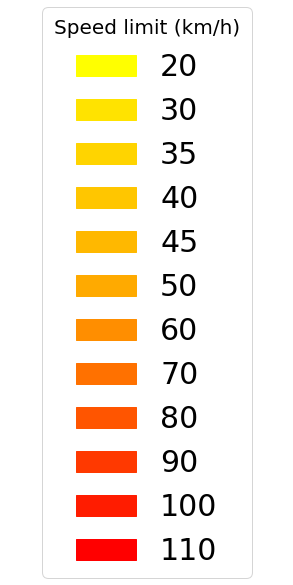

In [44]:
#creating legend using pyplot
fig, ax = plt.subplots()
fig.set_size_inches(5, 10.5)
handles = [mpatches.Patch(color=colors_dict[x], label=x) for x in colors_dict.keys()]
ax.legend(handles = handles, fontsize = 30, loc = "center", title = "Speed limit (km/h)", title_fontsize = "20")
fig.gca().set_axis_off()
fig.savefig("..\..\HTML_files\legend.png")

In [45]:
feature_speed = folium.map.FeatureGroup(name = "speed limits", overlay = True, show = True)

#add legend image to html
FloatImage("legend.png", bottom=-10, left=85).add_to(feature_speed)

#add roads and their corresponding color based on the speed limit
for row,speed in zip(list_coord_row, list_speed):
    for line in row:
        for coordinate in line:
            style = {'fillColor': colors_dict[speed], 'color': colors_dict[speed]}
            lines = MultiLineString([coordinate])
            geo = gpd.GeoSeries([lines]).__geo_interface__
            folium.GeoJson(geo, style_function=lambda x, fillColor = style["fillColor"], color = style["color"]: {"fillColor": fillColor, "color": color}).add_to(feature_speed)

In [46]:
#create map
# map_osm = folium.Map(location = [50.913577283979,-114.073657541927],control_scale = True, zoom_start=10)

#add heatmap
# create_heatmap(list_lat, list_long, map_osm, heat_name = "signs (playground, school)", list_weight = list_weight, r = 15)

#create grid array and markers feature layers
map_osm.add_child(feature_speed)
create_grid_array(grid_array, map_osm)
create_markers(map_osm, grid_array)

#add layer control
folium.LayerControl(position = "bottomleft").add_to(map_osm)

map_osm.save("..\..\HTML_files\layered_heat_map_grid_marker.html")
map_osm